<a href="https://colab.research.google.com/github/t0nyj/AbnormalDistribution/blob/master/10514273_Tejaswini_Kale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Installing all reqired packages 

In [101]:
!pip install plotly

##Importing labraries required for performing operations on data to get visuaalization

In [0]:
#Importing labraries required for prforming operations on data to get visuaalization
import altair as alt
from vega_datasets import data

import numpy as np
import requests
import pandas as pd
import plotly.plotly as py
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')
import plotly.graph_objs as go
from matplotlib import pyplot as plt

from  plotly.offline import plot

#py.tools.set_credentials_file(username='tejukale165dbs', api_key='wPmQdROeSaUBGWtRQiiu')

plotly.tools.set_credentials_file(username='tejukale165', api_key='QxpKnutVRiRgXB6pg9Sm')

##Loading Olympic Dataset
###Oplympic Dataset
1.    Olympic dataset have details of all  the Games from Athens 1896 to Rio 2016. 
Dataset is available on Kaggle : https://www.kaggle.com/heesoo37/120-years-of-olympic-history-athletes-and-results

2. We choose this dataset to provide analysis of the participation and performance of women, different nations, and different sports and event

3. The file athlete_events.csv contains 271116 rows and 15 columns. Each row corresponds to an individual athlete competing in an individual Olympic event (athlete-events). The columns are:

> *   ID - Unique number for each athlete
> * Name - Athlete's name
> * Sex - M or F
>* Age - Integer
>* Height - In centimeters
>*Weight - In kilograms
>*Team - Team name
>*NOC - National Olympic Committee 3-letter code
>*Games - Year and season
>*Year - Integer
>*Season - Summer or Winter
>*City - Host city
>*Sport - Sport
>*Event - Event
>*Medal - Gold, Silver, Bronze, or NA


In [103]:
#Disabling maximun number count in altair as we are using large dataset
alt.data_transformers.disable_max_rows()
#Read file athlete for github repository
athlete_events=pd.read_csv('https://raw.githubusercontent.com/t0nyj/AbnormalDistribution/master/input/athlete_events.csv')
athlete_events.head(3)

,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN


In [0]:
df=athlete_events.groupby('NOC',as_index=False)['Medal'].count()

In [105]:
df.head(3)

,NOC,Medal
0,AFG,2
1,AHO,1
2,ALB,0


In [0]:
#athlete_events=athlete_events.merge(df, on='NOC', how='inner')


In [106]:
athlete_events['Metal_num']=athlete_events.Medal.astype("category").cat.codes+1
athlete_events.head(3)


,ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Metal_num
0,1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,NaN,0
1,2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,NaN,0
2,3,Gunnar Nielsen Aaby,M,24.0,NaN,NaN,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,NaN,0


## Graph-1 : Geographic Map
### Geographic Map representes countries and number of medals won 

In [107]:
map_data = dict(
        type='choropleth',
        locations=df['NOC'],
        z=df['Medal'],
        text=df['NOC'],
        colorbar={'title': 'Medals Won'},
      )

map_layout = dict(
    title='Medals Won from 1890 to 2016',
    geo=dict(showframe=False)
)

map_actual = go.Figure(data=[map_data], layout=map_layout)
py.iplot(map_actual)

## Result

1. Map represents total nuber of medals won by diffrent countries form 1890 to 2016.
2. USA has won maximum number of medals 5637 followed by Canada with 1352 and third number in getting highest medal is Austarlia 1320

3. Some countries did win only 1 medal such as Gabon where as some countris did not win any



## Graph 2 : Bar Plot
### Mean age of winners on selection of year

In [109]:
data=athlete_events
goldMedals=data[data.Medal=='Gold']

year_dropdown = alt.binding_select(options=goldMedals['Year'].unique().tolist(), name="Year:")
year_select = alt.selection_single(fields=['Year'], bind=year_dropdown)


goldMedals.groupby('NOC')['Age'].mean()


alt.Chart(goldMedals).mark_bar(filled=True).encode(
    alt.X('NOC:N'),
    y='Age',
    tooltip="Age"
).add_selection(year_select).transform_filter(year_select).properties(width=700)


alt.Chart(...)

## Result
Plot represents mean age of winners with country from above two graphs we can annalyse that countries with less mean age have winned high number of medals.
This plot is interactive can check with each year difference in mean age of winners

## Graph 3 : Line Graph
###  Number of male and female participating in olympic with year

In [0]:
female_p=data[data.Sex=='F']
female_p.groupby('Year')['Sex'].count()
male_p=data[data.Sex=='M']
male_p.groupby('Year')['Sex'].count()

alt.Chart(male_p).mark_line(color='red').encode(
  x='Year',
  y='Sex'

).interactive() + alt.Chart(female_p).mark_line(color='blue').encode(
   x='Year',
  y='Sex'
).interactive()

## Result


1.   It is visible from graph that till 1920 there was no pticiption for female where as with development there is growth in number of females participating in olympic.
2.   From 1994 there is minimal difference in male and female participances  




## Ghraph 4 : Donut Pie Chart
### Top 10 countries with medals by sex

In [134]:
topn = 10
data=athlete_events
male = data[data.Sex=='M']
female = data[data.Sex=='F']
count_male = male.dropna().NOC.value_counts()[:topn].reset_index()
count_female = female.dropna().NOC.value_counts()[:topn].reset_index()

pie_men = go.Pie(labels=count_male['index'],values=count_male.NOC,name="Men",hole=0.4,domain={'x': [0,0.46]})
pie_women = go.Pie(labels=count_female['index'],values=count_female.NOC,name="Women",hole=0.4,domain={'x': [0.5,1]})

layout = dict(title = 'Top-10 countries with medals by sex', font=dict(size=15), legend=dict(orientation="h"),
              annotations = [dict(x=0.2, y=0.5, text='Men', showarrow=False, font=dict(size=20)),
                             dict(x=0.8, y=0.5, text='Women', showarrow=False, font=dict(size=20)) ])

fig = dict(data=[pie_men, pie_women], layout=layout)
py.iplot(fig)

## Result


1.   USA has highest number of male and female medal winners.
2. Where as countries like united kindom and Finland have great apperiance in male catagory and does not show that great participation in female catagory
3. China is only country which is among top 10 medal winner in femal catagory who does not come in top 10 for male catagory




## Graph 5 : Bar Plot
### Countries with number of gold medals won when olymic held on  selected  venue

In [0]:
data = athlete_events

In [131]:
goldMedals=data[data.Medal=='Gold']
goldMedals.groupby('NOC')

In [0]:
venue_dropdown = alt.binding_select(options=goldMedals['City'].unique().tolist(), name="Venue:")
venue_select = alt.selection_single(fields=['City'], bind=venue_dropdown)

In [133]:
alt.Chart(goldMedals).mark_bar(color='maroon').encode(
x=alt.X('NOC', title="Countries"),
y=alt.Y('count()', title='No of gold medals')
).add_selection(venue_select).transform_filter(venue_select).properties(width=700)

alt.Chart(...)

##Result
Plot represents number of gold medals won by countries when held on selecteded venue.
From this graph we can analyse which country performed well in which city 

## Graph 6 : Heat Map 
### Mean Age of Medal Winner

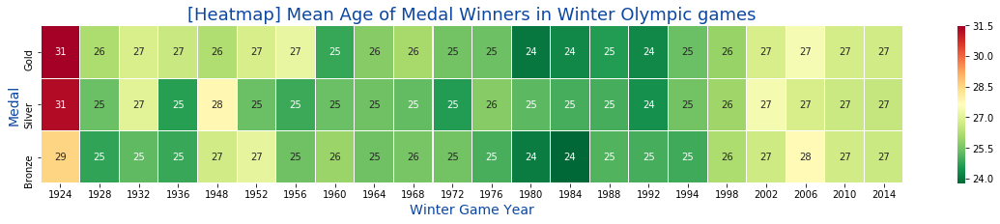

In [100]:
year_sport_age = athlete_events[athlete_events['Season']=='Winter'].pivot_table(athlete_events, index=['Year','Medal'], aggfunc=np.mean).reset_index()[['Year','Medal','Age']]
year_sport_age = year_sport_age.pivot("Medal", "Year", "Age")
year_sport_age = year_sport_age.reindex(["Gold","Silver","Bronze"])
f, ax = plt.subplots(figsize=(20, 3))
sns.heatmap(year_sport_age, annot=True, linewidths=0.05, ax=ax, cmap="RdYlGn_r")
ax.set_xlabel('Winter Game Year', size=14, color="#0D47A1")
ax.set_ylabel('Medal', size=14, color="#0D47A1")
ax.set_title('[Heatmap] Mean Age of Medal Winners in Winter Olympic games', size=18, color="#0D47A1")
plt.show()

## Result 
1. This heat map represents mean age of Medal winners with year from visualization it is understandable that from 1964 to 1994 mean age of winner was less than 25 where as  on both ends of map mean age high .
2.It can be observerd that most of the gold medalist are experienced than brownze medalist player 

## Graph 7 : Bar Plot
### Age dristibutuion of male and females by sport 

In [0]:
sport_dropdown = alt.binding_select(options=data['Sport'].unique().tolist(), name="Venue:")
sport_select = alt.selection_single(fields=['Sport'], bind=sport_dropdown)
men = data[data.Sex=='M']
women=data[data.Sex=='F']
p1 = alt.Chart(men).mark_bar(color='red').encode(
y='count()',
x='Age:N').add_selection(sport_select).transform_filter(sport_select).properties(width=500, title='Age distribution of males by sport')
p2 = alt.Chart(women).mark_bar(color='blue').encode(
y='count()',
x='Age:N').add_selection(sport_select).transform_filter(sport_select).properties(width=500, title='Age distribution of females by sport')

In [32]:
p1 | p2

alt.HConcatChart(...)

## Result : 
Plot represents age distribution  of male and females depending on sport selection.
From this graph we can analyse which age group have more participants in diffeent sports.
For swimming age group 19 to 24 have maximum participants where as for femals it is 16 to 23